## 数据扩增为什么有用

在深度学习模型的训练过程中，数据扩增是必不可少的环节。现有深度学习的参数非常多，一般的模型可训练的参数量基本上都是万到百万级别，而训练集样本的数量很难有这么多

## 有哪些数据扩增方法

**第一类是基于基本图像处理技术的数据增强**  
- 几何变换（Geometric Transformations）：由于训练集与测试集合中可能存在潜在的位置偏差，使得模型在测试集中很难达到训练集中的效果，几何变换可以有效地克服训练数据中存在的位置偏差，而且易于实现，许多图像处理库都包含这个功能。

- 颜色变换（Color Space）：图片在输入计算机之前，通常会被编码为张量（高度×宽度×颜色通道），所以可以在色彩通道空间进行数据增强，比如将某种颜色通道关闭，或者改变亮度值。

- 旋转 | 反射变换（Rotation/Reflection）：选择一个角度，左右旋转图像，可以改变图像内容朝向。关于旋转角度需要慎重考虑，角度太大或者太小都不合适，适宜的角度是1度 到 20度。

- 噪声注入（Noise Injection）：从高斯分布中采样出的随机值矩阵加入到图像的RGB像素中，通过向图像添加噪点可以帮助CNN学习更强大的功能。

- 内核过滤器（Kernel Filters）：内核滤镜是在图像处理中一种非常流行的技术，比如锐化和模糊。将特定功能的内核滤镜与图像进行卷积操作，就可以得到增强后的数据。直观上，数据增强生成的图像可能会使得模型面对这种类型的图像具有更高的鲁棒性。

- 混合图像（Mix）：通过平均图像像素值将图像混合在一起是一种非常违反直觉的数据增强方法。对于人来说，混合图像生成的数据似乎没有意义。虽然这种方法缺乏可解释性，但是作为一种简单有效的数据增强算法，有一系列的工作进行相关的研究。Inoue在图像每个像素点混合像素值来混合图像，Summers和Dinneen又尝试以非线性的方法来混合图像，Takahashi和Matsubara通过随机图像裁剪和拼接来混合图像，以及后来的mixup方法均取得了不错的成果。

- 随机擦除（Random Erasing）：随机擦除是Zhong等人开发的数据增强技术。他们受到Dropout机制的启发，随机选取图片中的一部分，将这部分图片删除，这项技术可以提高模型在图片被部分遮挡的情况下性能，除此之外还可以确保网络关注整个图像，而不只是其中的一部分。

- 缩放变换（Zoom）：图像按照一定的比例进行放大和缩小并不改变图像中的内容，可以增加模型的泛化性能。
- 移动（Translation）：向左，向右，向上或向下移动图像可以避免数据中的位置偏差，比如在人脸识别数据集合中，如果所有图像都居中，使用这种数据增强方法可以避免可能出现的位置偏差导致的错误。

- 翻转变换（Flipping）：通常是关于水平或者竖直的轴进行图像翻转操作，这种扩充是最容易实现的扩充，并且已经证明对ImageNet数据集有效。

- 裁剪（Cropping）：如果输入数据集合的大小是变化的，裁剪可以作为数据预处理的一个手段，通过裁剪图像的中央色块，可以得到新的数据。在实际使用过程之中，这些数据增强算法不是只使用一种，而是使用一套数据增强策略

**第二个类别是基于深度学习的数据增强算法**  
- 特征空间增强（Feature Space Augmentation）：神经网络可以将图像这种高维向量映射为低维向量，之前讨论的所有图像数据增强方法都应用于输入空间中的图像。现在可以在特征空间进行数据增强操作，例如：SMOTE算法，它是一种流行的增强方法，通过将k个最近的邻居合并以形成新实例来缓解类不平衡问题。

- 对抗生成（Adversarial Training）：对抗攻击表明，图像表示的健壮性远不及预期的健壮性，Moosavi-Dezfooli等人充分证明了这一点。对抗生成可以改善学习的决策边界中的薄弱环节，提高模型的鲁棒性。

- 基于GAN的数据增强（GAN-based Data Augmentation）：使用 GAN 生成模型来生成更多的数据，可用作解决类别不平衡问题的过采样技术。

- 神经风格转换（Neural Style Transfer）：通过神经网络风格迁移来生成不同风格的数据，防止模型过拟合。


链接：https://link.springer.com/article/10.1186/s40537-019-0197-0

从颜色空间、尺度空间到样本空间，同时根据不同任务数据扩增都有相应的区别。  
对于图像分类，数据扩增一般不会改变标签；  
对于物体检测，数据扩增会改变物体坐标位置；  
对于图像分割，数据扩增会改变像素标签。

## 几种数据增强的库

### torchvision  
API链接：https://pytorch.org/docs/stable/torchvision/transforms.html

#### 裁剪  
中心裁剪：transforms.CenterCrop；  
随机裁剪：transforms.RandomCrop；  
随机长宽比裁剪：transforms.RandomResizedCrop；  
上下左右中心裁剪：transforms.FiveCrop；  
上下左右中心裁剪后翻转: transforms.TenCrop。  
#### 翻转和旋转  
依概率p水平翻转：transforms.RandomHorizontalFlip(p=0.5)；  
依概率p垂直翻转：transforms.RandomVerticalFlip(p=0.5)；  
随机旋转：transforms.RandomRotation。  
#### 随机遮挡  
对图像进行随机遮挡: transforms.RandomErasing。  
#### 图像变换  
尺寸变换：transforms.Resize；  
标准化：transforms.Normalize；  
填充：transforms.Pad；  
修改亮度、对比度和饱和度：transforms.ColorJitter；  
转灰度图：transforms.Grayscale；  
依概率p转为灰度图：transforms.RandomGrayscale；  
线性变换：transforms.LinearTransformation()；  
仿射变换：transforms.RandomAffine；  
将数据转换为PILImage：transforms.ToPILImage；  
转为tensor，并归一化至[0-1]：transforms.ToTensor；  
用户自定义方法：transforms.Lambda。  
#### 对transforms操作，使数据增强更灵活  
transforms.RandomChoice(transforms): 从给定的一系列transforms中选一个进行操作；  
transforms.RandomApply(transforms, p=0.5): 给一个transform加上概率，依概率进行操作；  
transforms.RandomOrder: 将transforms中的操作随机打乱。 

### ImgAug  
Git链接：https://github.com/aleju/imgaug
教程：https://imgaug.readthedocs.io/en/latest/source/jupyter_notebooks.html

#### 许多增强技术
例如仿射变换，透视图变换，对比度变化，高斯噪声，区域丢失，色相/饱和度变化，修剪/填充，模糊，...
为高性能而优化
易于仅将增强应用于某些图像
易于以随机顺序应用增强
#### 支持
图像（完全支持uint8，有关其他dtype的信息，请参阅文档）
热图（float32），分段图（int），蒙版（布尔）
可能小于/大于其对应的图像。不需要额外的代码行来进行裁剪。
关键点/地标（整数/浮点坐标）
边界框（整数/浮点坐标）
多边形（整数/浮点坐标）
线串（整数/浮点坐标）
#### 自动对齐采样的随机值
示例：以上采样的相同值旋转图像和分割图uniform(-10°, 45°)。（0条额外的代码行。）
#### 概率分布作为参数
示例：按从采样的值旋转图像uniform(-10°, 45°)。
示例：按从ABS(N(0, 20.0))*(1+B(1.0, 1.0))“” 采样的值旋转图像，其中ABS(.)是绝对函数，N(.)高斯分布和B(.)beta分布。
#### 许多辅助功能
示例：绘制热图，分段图，关键点，边界框，...
示例：比例分割贴图，图像/贴图的平均/最大池，填充图像与长宽比（例如将它们平方）
示例：将关键点转换为距离图，从图像中提取边界框内的像素，将多边形裁剪到图像平面，...
#### 支持多个CPU内核上的扩充

### albumentations  
GIT: https://github.com/albumentations-team/albumentations   
示例：https://www.aiuai.cn/aifarm422.html

#### Pixel-level transforms

模糊
克拉
ChannelDropout
ChannelShuffle
粗滴
小型化
均衡
花式PCA
FromFloat
高斯噪声
高斯模糊
玻璃模糊
色相饱和度值
IAA添加剂高斯噪声
IAAEmboss
国际原子能机构
IAA超像素
ISO噪声
图像压缩
倒置
中位模糊
运动模糊
乘性噪声
归一化
海报化
RGBShift
随机亮度对比
随机雾
随机伽玛
随机雨
随机阴影
随机雪
随机太阳耀斑
日晒
漂浮
到灰色
到深褐色

#### Spatial-level transforms

中心作物 
作物 
CropNonEmptyMaskIfExists 
弹性 
翻转 
网格 
网格 
水平翻转 
IAAA仿射 
IAACropAndPad 
国际田联 
国际田联 
IAA观点 
IAAP分级仿射 
拉姆达 
最长最大大小 
遮罩 
无操作 
光学 
如果需要 
随机作物 
RandomCropNearBBox 
RandomGridShuff 
随机调整大小的作物 
随机旋转90 
随机标度 
RandomSizedBBoxSafeCro 
随机大小作物 
调整大小 
旋转 
ShiftScaleRotate 
最小最大尺寸 
转置 
垂直翻转

### keras.proprecessing.image 
API: https://keras.io/api/preprocessing/image/

在训练的时候增强

### DALA  
API链接：https://docs.nvidia.com/deeplearning/dali/user-guide/docs/examples/image_processing/index.html

## 演示

### torchvision

In [1]:
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
%matplotlib inline

(1280, 720)


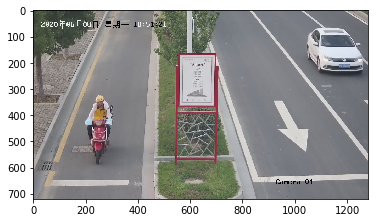

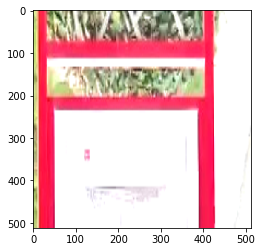

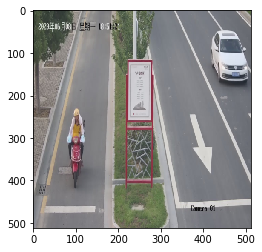

In [2]:
trans_list = [transforms.CenterCrop((100,200)),           #中心截取图像大小 ,
             transforms.RandomHorizontalFlip(p=0),   #水平翻转
             transforms.RandomVerticalFlip(p=1),   # 垂直翻转
             transforms.ColorJitter(brightness=0.8, contrast=0.5, saturation=0, hue=0),  #（亮度= 0，对比度= 0，饱和度= 0，色相= 0 ）
             transforms.Resize((512,512))   #放大图像
             ]
my_trans = transforms.Compose(trans_list)

my_train1 = transforms.RandomChoice(trans_list)   #随机选择一种操作

img = Image.open(r'zq/2.jpg')
print(img.size)

imshow(img)
plt.show()

my_img = my_trans(img)
imshow(my_img)
plt.show()

my_img1 = my_train1(img)
imshow(my_img1)
plt.show()

### ImgAug

In [3]:
import imageio
import imgaug as ia
from imgaug import augmenters as iaa
# pip install imgaug==0.4.0   #不然运行不了

In [4]:
ia.__version__

'0.4.0'

(720, 1280, 3)


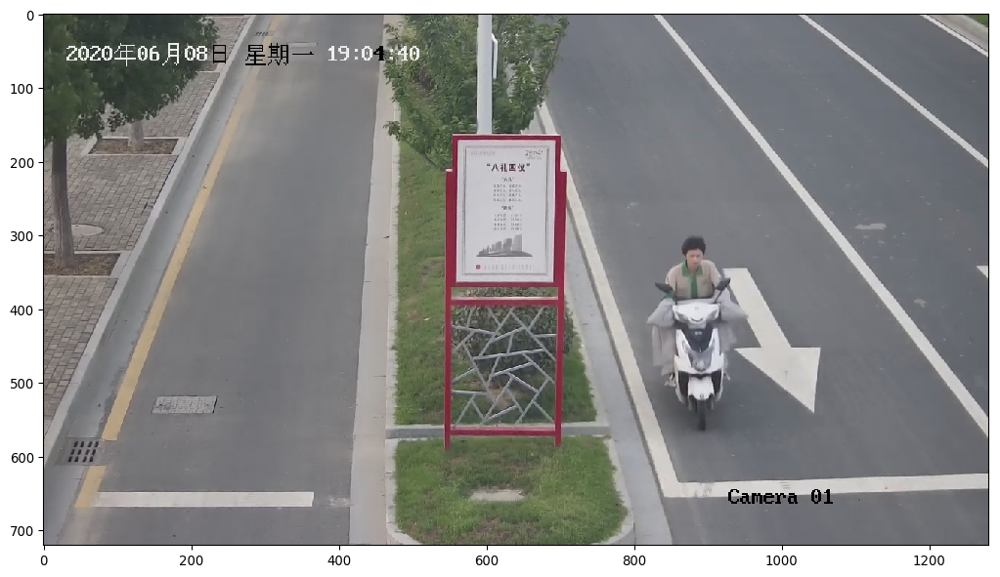

In [62]:
image = imageio.imread("zq/1.jpg")
print(image.shape)
ia.imshow(image)

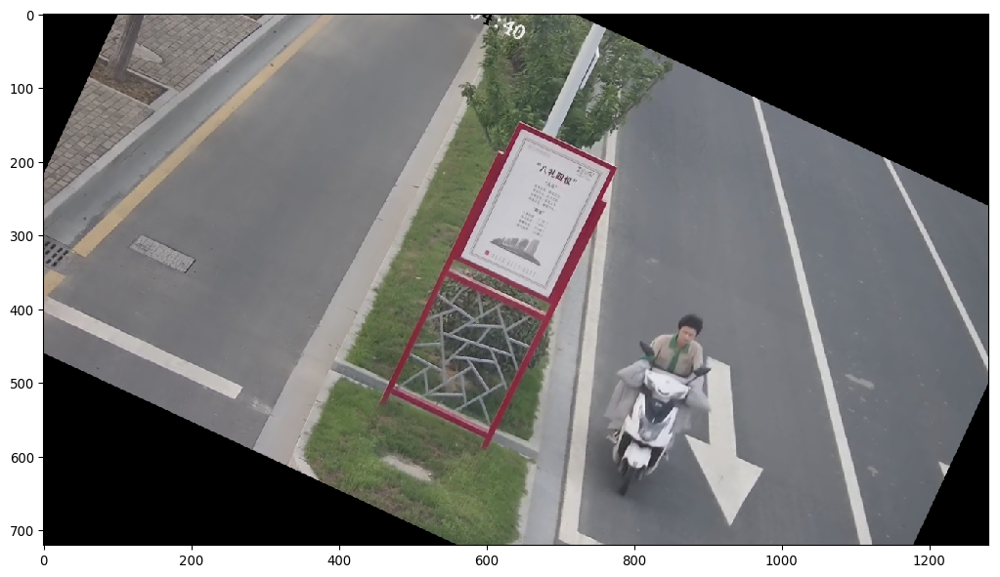

In [63]:
rotate = iaa.Affine(rotate=(-25, 25))
image_aug = rotate(image=image)
ia.imshow(image_aug)

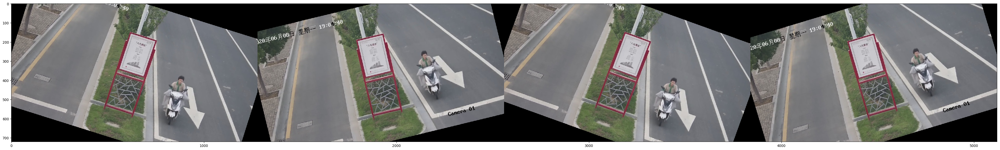

In [64]:
import numpy as np
images = [image, image, image, image]
images_aug = rotate(images=images)
ia.imshow(np.hstack(images_aug))

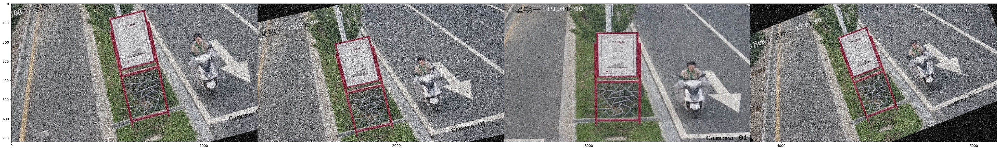

In [68]:
seq = iaa.Sequential([
    iaa.Affine(rotate=(-25, 25)),
    iaa.AdditiveGaussianNoise(scale=(10, 60)),
    iaa.Crop(percent=(0, 0.2))
])
images_aug = seq(images=images)
ia.imshow(np.hstack(images_aug))

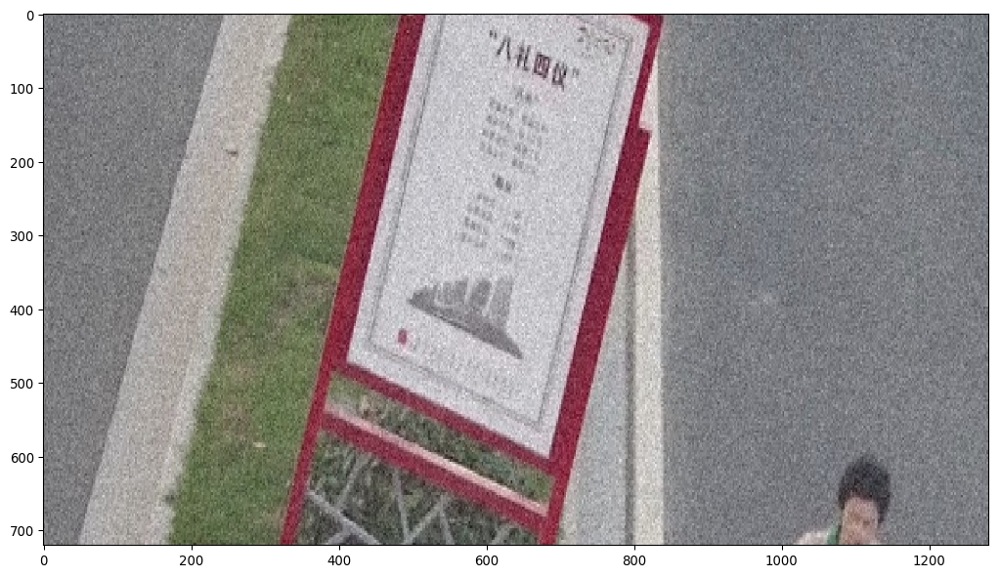

In [66]:
seq = iaa.Sequential([
    iaa.Affine(rotate=(-25, 25)),
    iaa.AdditiveGaussianNoise(scale=(10, 60)),
    iaa.Crop(percent=(0, 0.5))
])
images_aug = seq(image=image)
ia.imshow(images_aug)

In [69]:
aug = iaa.RandAugment(n=2,m=9)

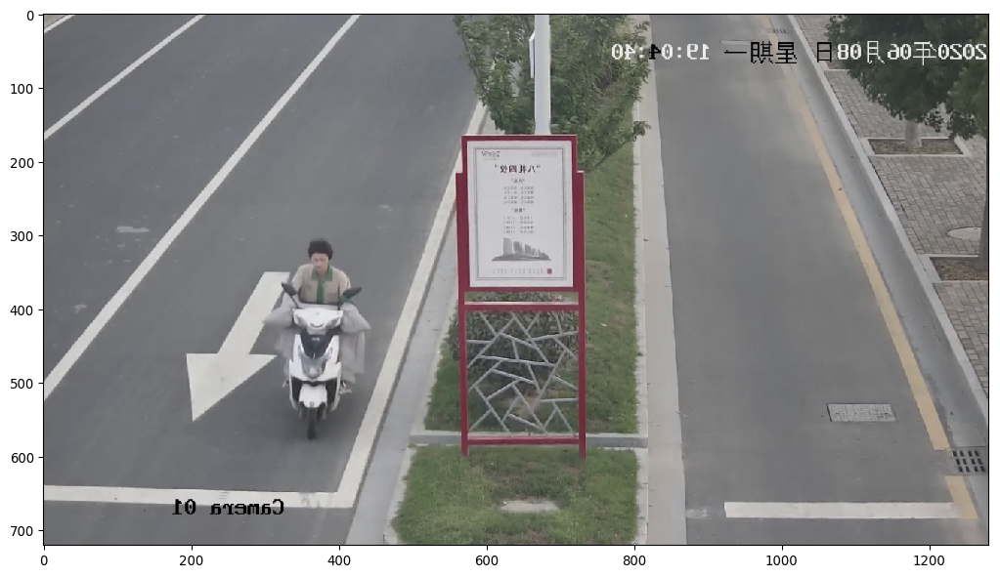

In [77]:
images_aug = aug(image=image)
ia.imshow(images_aug)

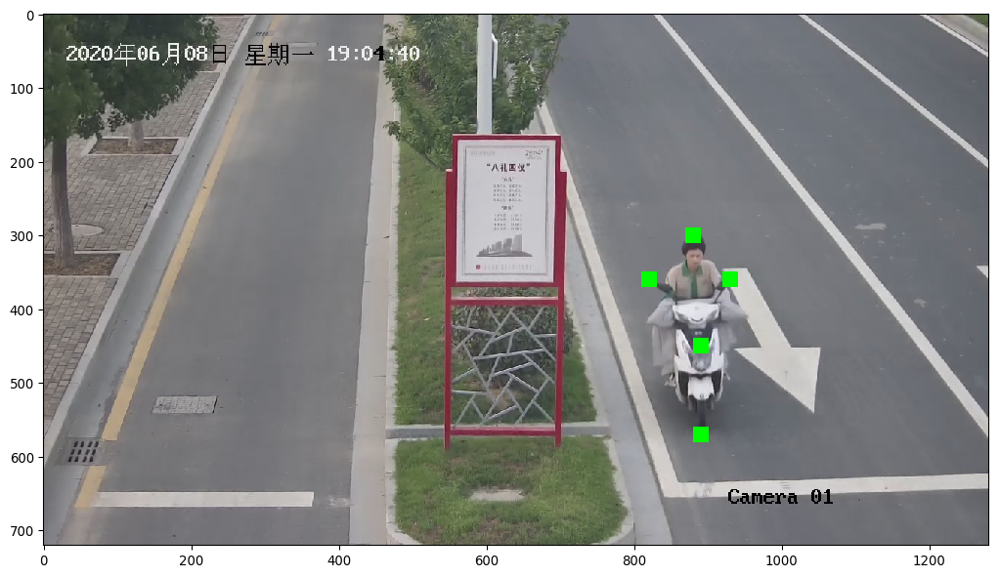

In [12]:
from imgaug.augmentables.kps import Keypoint, KeypointsOnImage

image = imageio.imread("zq/1.jpg")
kps = [
    Keypoint(x=880, y=300),   # 头
    Keypoint(x=820, y=360),  # 右镜子
    Keypoint(x=890, y=450), # 车头
    Keypoint(x=930, y=360), # 左镜子
    Keypoint(x=890, y=570)  # 脚
]
kpsoi = KeypointsOnImage(kps, shape=image.shape)
ia.imshow(kpsoi.draw_on_image(image, size=20))

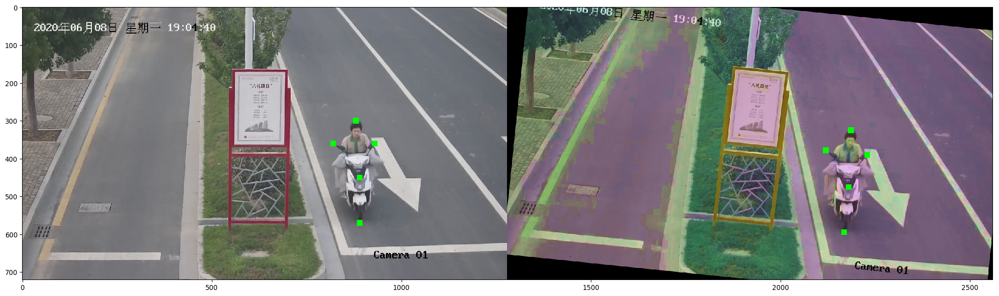

In [13]:
seq = iaa.Sequential([
    iaa.Affine(translate_px={"x": (10, 30)}, rotate=(-10, 10)),  #x偏移，旋转
    iaa.AddToHueAndSaturation((-50, 50))                           #增加色相、饱和度
])
image_aug, kpsoi_aug = seq(image=image, keypoints=kpsoi)
ia.imshow(
    np.hstack([
        kpsoi.draw_on_image(image, size=15),
        kpsoi_aug.draw_on_image(image_aug, size=15)
    ])
)

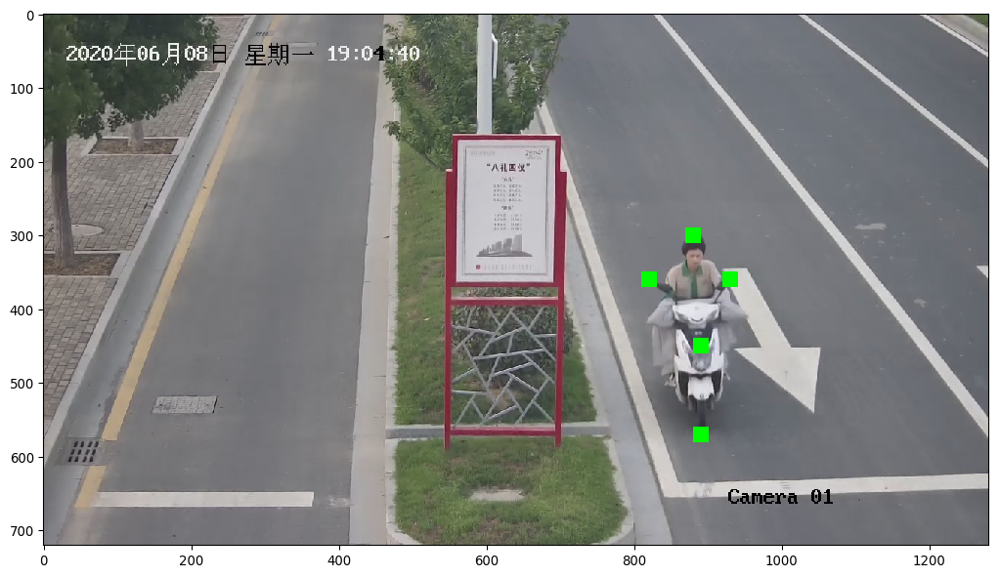

In [14]:
ia.imshow(kpsoi.draw_on_image(image, size=20))

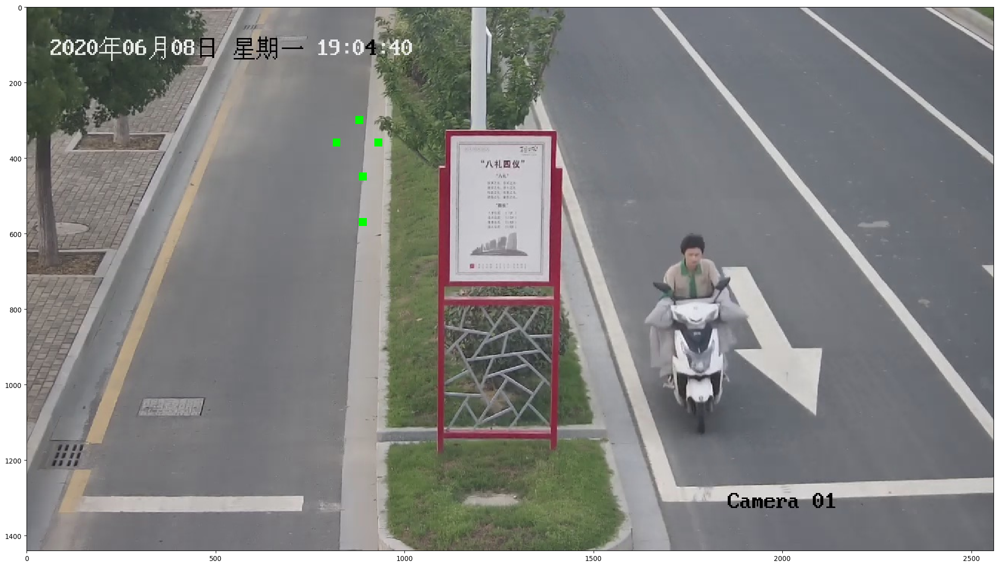

In [15]:
image_larger = ia.imresize_single_image(image, 2.0)   #放大2倍
ia.imshow(kpsoi.draw_on_image(image_larger, size=20))

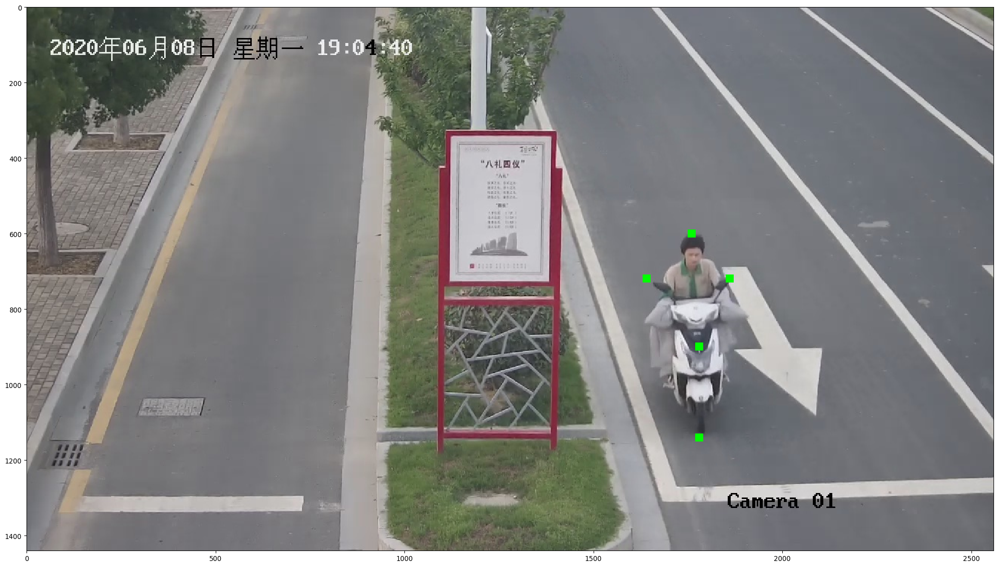

In [16]:
ia.imshow(kpsoi.on(image_larger).draw_on_image(image_larger, size=20))

D:\Anaconda3\lib\site-packages\imgaug\imgaug.py:106: DeprecationWarning: Using imgaug.imgaug.pad is deprecated. Use imgaug.augmenters.size.pad instead.
  warn(msg, category=DeprecationWarning, stacklevel=stacklevel)


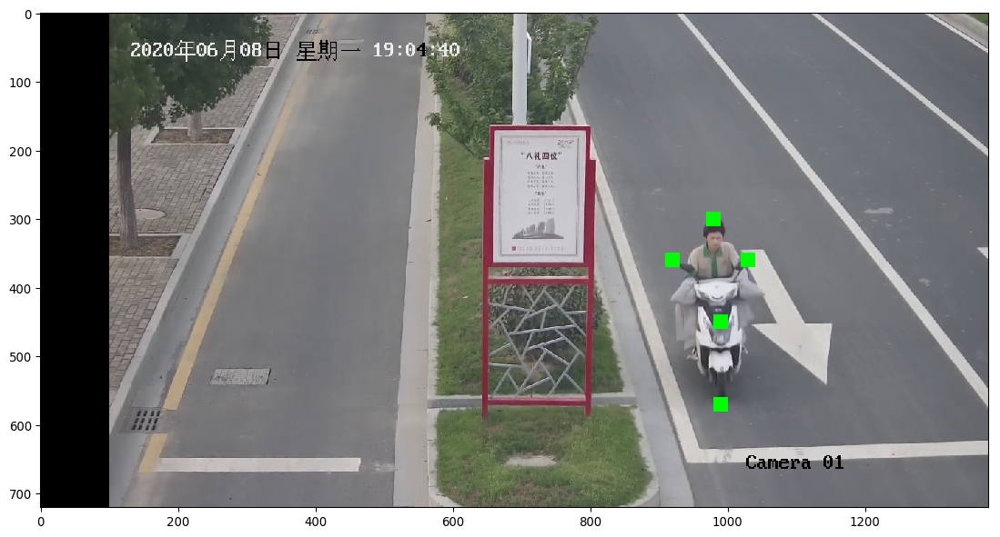

In [17]:
image_pad = ia.pad(image, left=100)
kpsoi_pad = kpsoi.shift(x=100)
ia.imshow(kpsoi_pad.draw_on_image(image_pad, size=20))

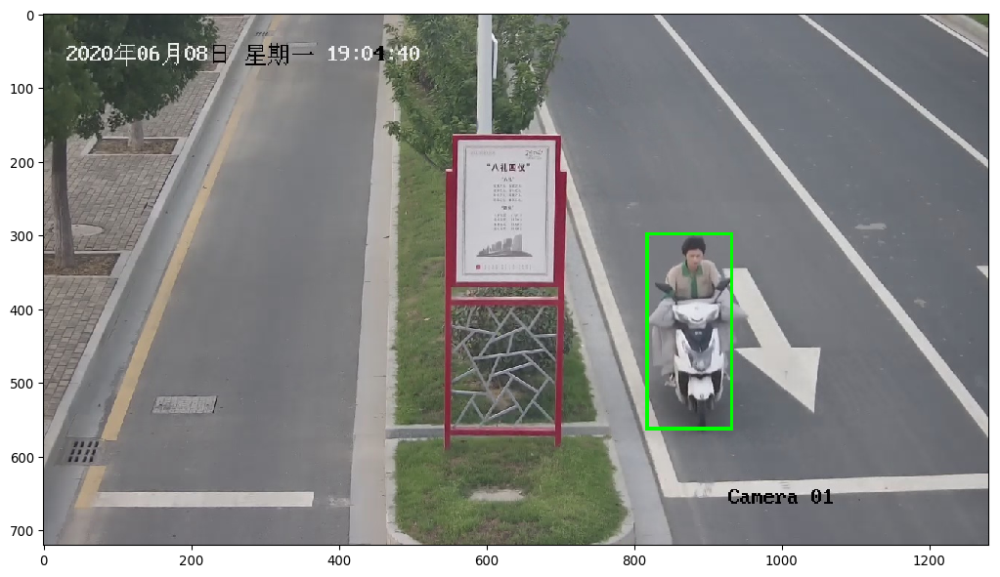

In [18]:
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
bbs = BoundingBoxesOnImage([
    BoundingBox(x1=820, x2=930, y1=300, y2=560),
], shape=image.shape)

ia.imshow(bbs.draw_on_image(image, size=5))

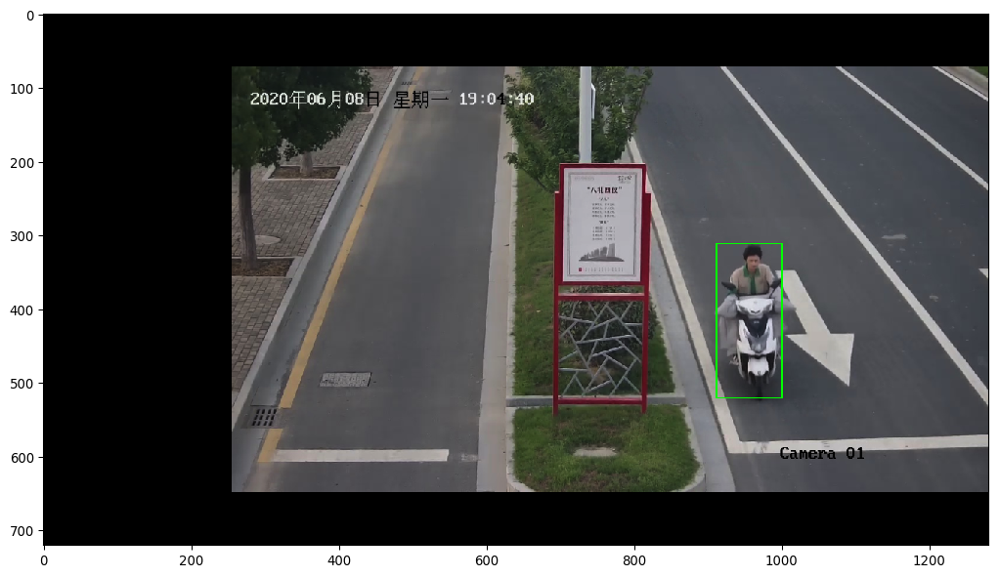

In [19]:
seq = iaa.Sequential([
    iaa.GammaContrast(1.5),
    iaa.Affine(translate_percent={"x": 0.1}, scale=0.8)
])
image_aug, bbs_aug = seq(image=image, bounding_boxes=bbs)
ia.imshow(bbs_aug.draw_on_image(image_aug, size=2))

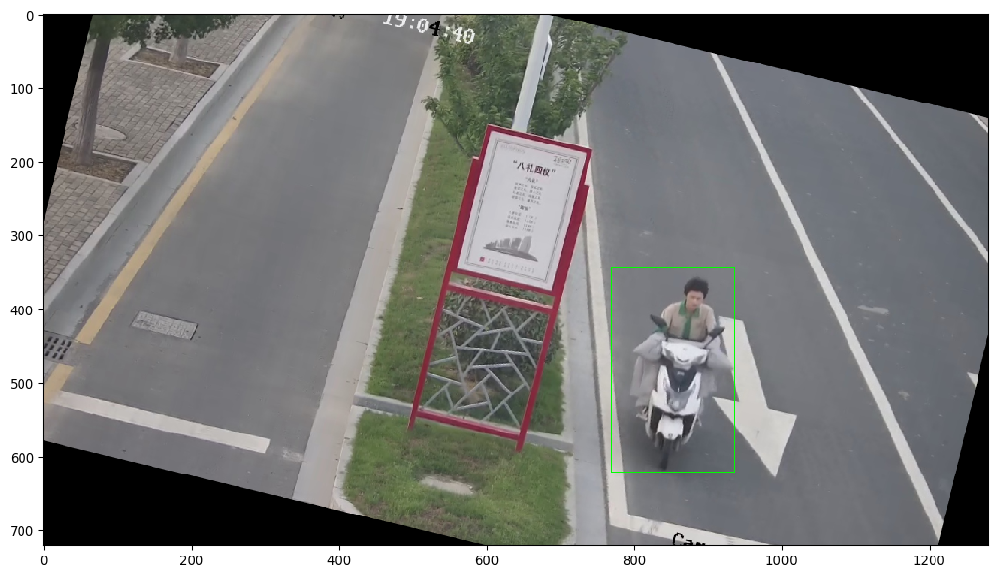

In [20]:
image_aug, bbs_aug = iaa.Affine(rotate=(10,30))(image=image, bounding_boxes=bbs)
ia.imshow(bbs_aug.draw_on_image(image_aug))

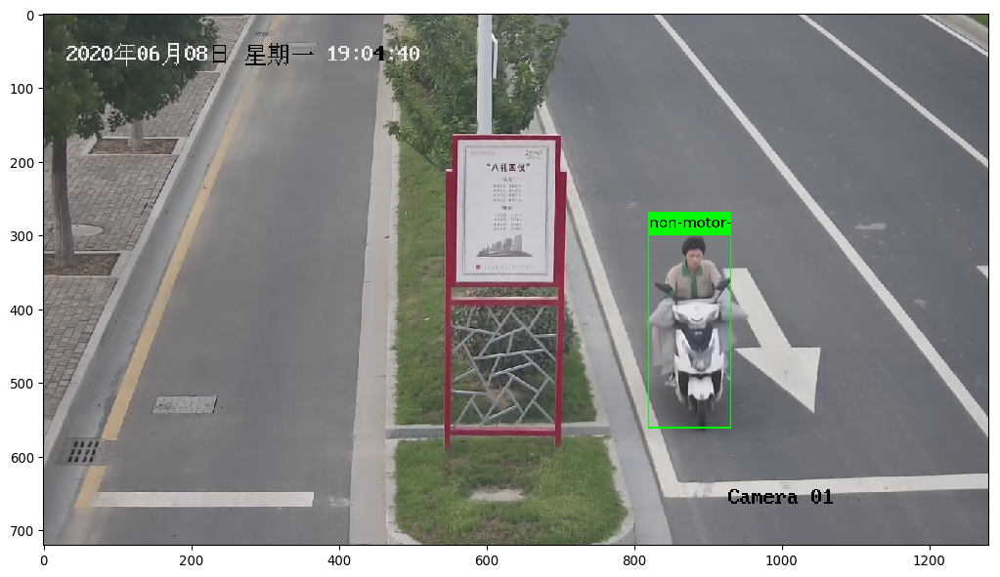

In [21]:
bbs_labeled = bbs.deepcopy()
bbs_labeled[0].label = "non-motor-vehicle,motorcycle"
image_bbs = bbs_labeled.draw_on_image(image, size=2)
ia.imshow(image_bbs)

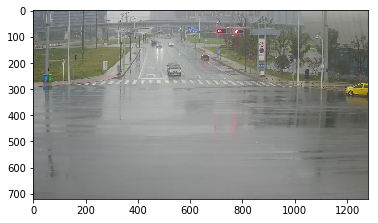

In [22]:
image = imageio.imread('./zq/30680.jpg')
imshow(image)

In [23]:
import json

In [24]:
with open('./zq/30680.json','r') as f:
    data = json.load(f)

In [25]:
for k in data['shapes']:
    if k.get('label')=='car':
        print(k.get('points'))

[[650.6302521008404, 162.60504201680672], [670.7983193277312, 164.07563025210084], [672.2689075630252, 170.3781512605042], [673.529411764706, 186.55462184873952], [668.6974789915967, 186.55462184873952], [668.2773109243698, 183.82352941176472], [648.5294117647059, 184.2436974789916], [647.0588235294118, 186.34453781512605], [641.5966386554622, 183.61344537815125], [642.0168067226891, 172.47899159663865], [646.8487394957983, 166.5966386554622]]
[[516.4406779661017, 123.89830508474576], [532.0338983050847, 122.88135593220338], [536.6101694915254, 125.42372881355931], [537.9661016949152, 137.96610169491524], [535.0847457627118, 137.45762711864407], [521.0169491525423, 136.10169491525423], [519.3220338983051, 138.9830508474576], [514.4067796610169, 136.61016949152543], [514.4067796610169, 127.11864406779661]]
[[523.0179028132992, 207.41687979539643], [557.0332480818414, 207.1611253196931], [563.1713554987213, 210.230179028133], [561.1253196930946, 213.81074168797954], [562.148337595908, 21

In [26]:
from imgaug.augmentables.polys import Polygon

In [27]:
label=[]
for k in data['shapes']:
    if k.get('label')=='car':
        label.append(k.get('points'))

In [28]:
kpsoi_chipmunk=[]
for i in range(len(label)):
    kpsoi_chipmunk.append(KeypointsOnImage.from_xy_array(label[i], shape=image.shape))

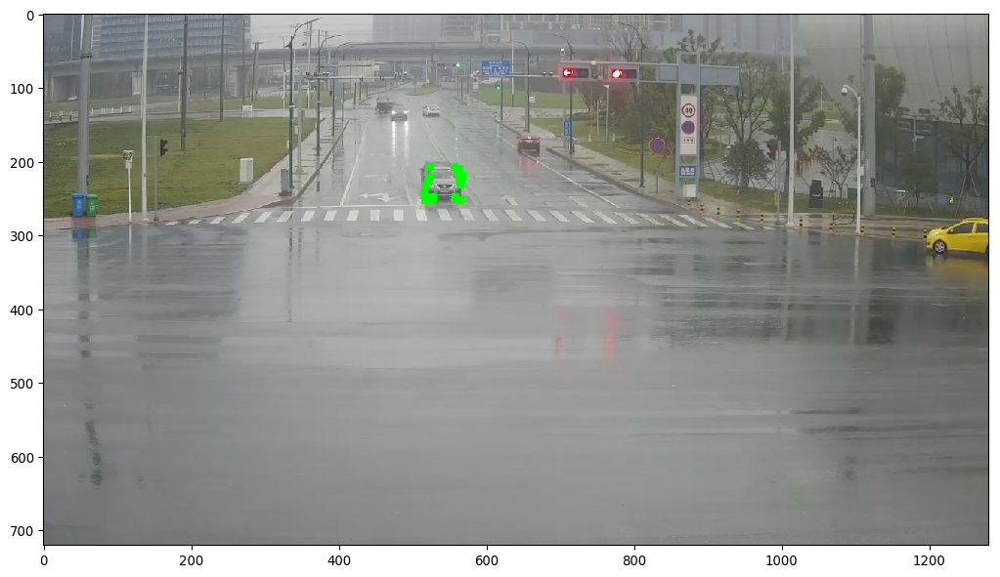

In [29]:
ia.imshow(kpsoi_chipmunk[2].draw_on_image(image, size=10))

In [30]:
poly_point=[]
for i in range(0,4):
    poly_point.append(Polygon(kpsoi_chipmunk[i].keypoints))

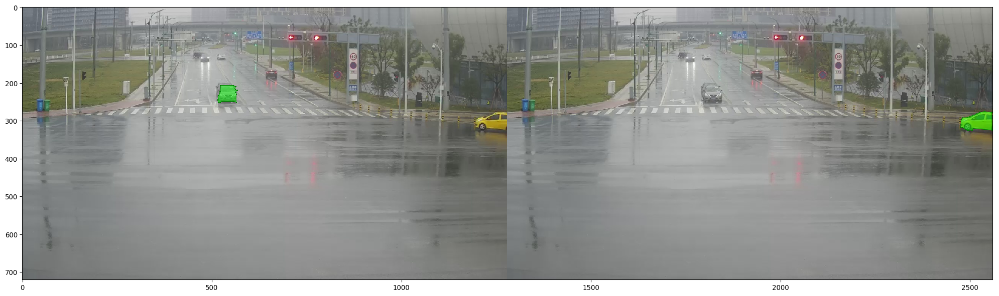

In [31]:
ia.imshow(np.hstack([poly_point[2].draw_on_image(image),poly_point[3].draw_on_image(image)]))

In [32]:
# create empty segmentation map for classes: background, tree, chipmunk
segmap = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)

# draw the tree polygon into the second channel
segmap = poly_point[2].draw_on_image(
    segmap,
    color=(0, 255, 0),
    alpha=1.0, alpha_lines=0.0, alpha_points=0.0)

# draw the chipmunk polygon into the third channel
segmap = poly_point[3].draw_on_image(
    segmap,
    color=(0, 0, 255),
    alpha=1.0, alpha_lines=0.0, alpha_points=0.0)

# merge the three channels to a single one
segmap = np.argmax(segmap, axis=2)

# change dtype from int64 to int32, as int32 is the allowed maximum in SegmentationMapsOnImage
segmap = segmap.astype(np.int32)

# draw statistics about our segmentation map
print("Shape:", segmap.shape, "min value:", segmap.min(), "max value:", segmap.max())

Shape: (720, 1280) min value: 0 max value: 2


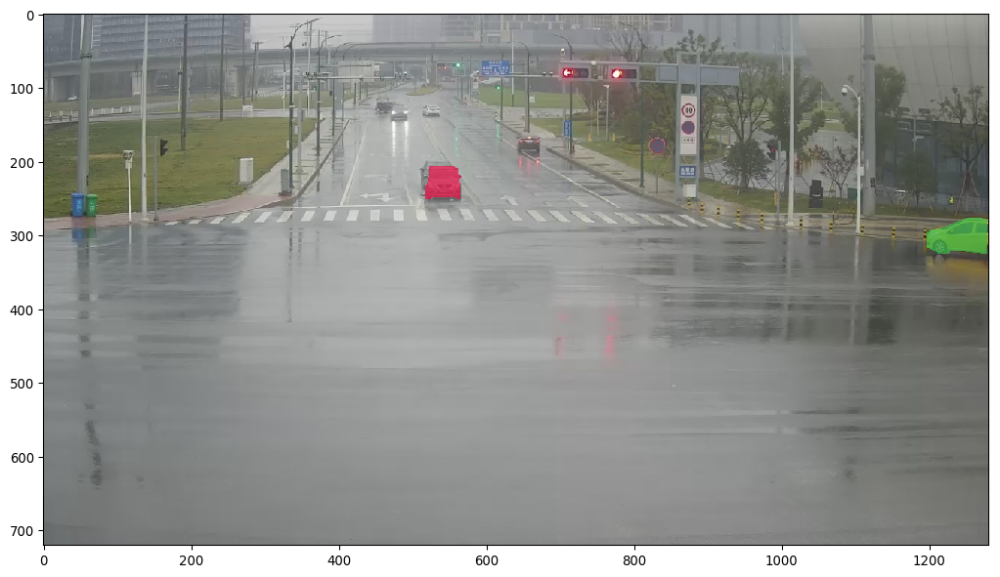

In [33]:
from imgaug.augmentables.segmaps import SegmentationMapsOnImage

segmap = SegmentationMapsOnImage(segmap, shape=image.shape)

ia.imshow(segmap.draw_on_image(image)[0])

In [34]:
import imgaug.augmenters as iaa
ia.seed(2)

seq = iaa.Sequential([
    #iaa.CoarseDropout(0.1, size_percent=0.2),
    iaa.Affine(rotate=(-30, 30)),
    #iaa.ElasticTransformation(alpha=10, sigma=1)
])

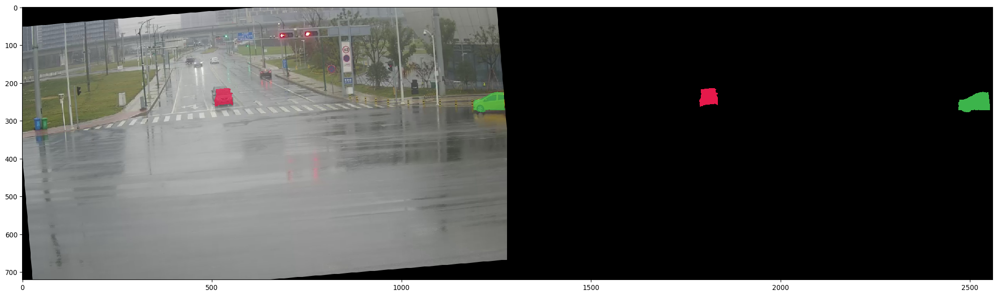

In [35]:
image_aug, segmap_aug = seq(image=image, segmentation_maps=segmap)

ia.imshow(np.hstack([
    segmap_aug.draw_on_image(image_aug)[0],  # show blend of (augmented) image and segmentation map
    segmap_aug.draw()[0]  # show only the augmented segmentation map
]))

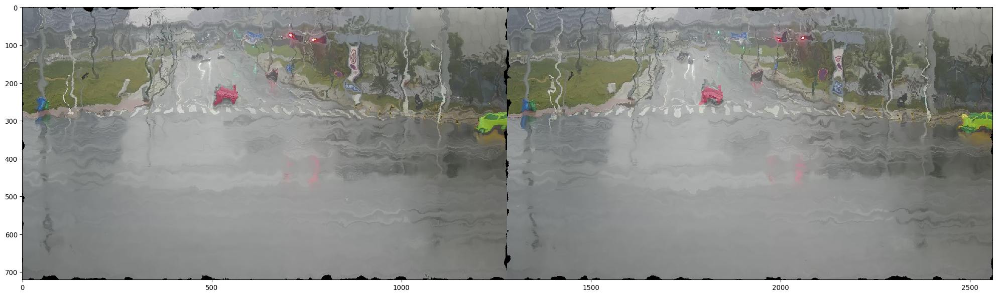

In [36]:
aug = iaa.ElasticTransformation(alpha=200, sigma=10)

image_aug, segmap_aug = aug(image=image, segmentation_maps=segmap)

image_aug_unaligned = aug(image=image)
segmap_aug_unaligned = aug(segmentation_maps=segmap)

ia.imshow(
    np.hstack([
        segmap_aug.draw_on_image(image_aug, alpha=0.4)[0],
        segmap_aug.draw_on_image(image_aug_unaligned, alpha=0.4)[0]
    ])
)

In [37]:
segmap_small = segmap.resize(0.25)
print("Before:", segmap.arr.shape, "After:", segmap_small.arr.shape)

Before: (720, 1280, 1) After: (180, 320, 1)


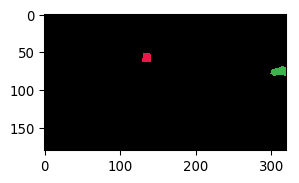

In [38]:
ia.imshow(segmap_small.draw()[0])

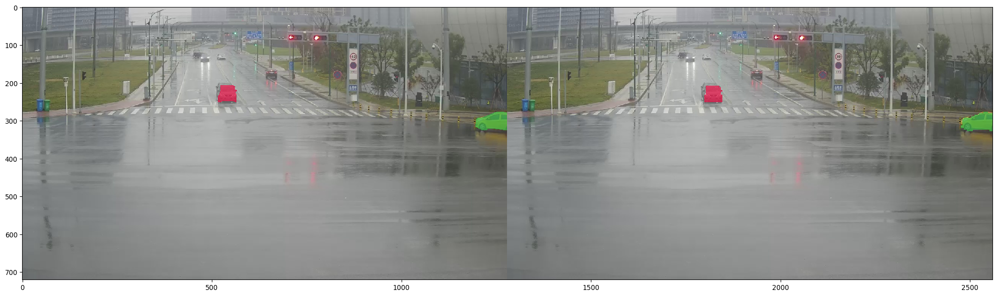

In [39]:
ia.imshow(
    np.hstack([
        segmap.draw_on_image(image)[0],
        segmap_small.draw_on_image(image)[0]
    ])
)

In [40]:
print("Image size: %s Segmentation Map size: %s (on image with shape: %s)" % (
    image.shape, segmap_small.arr.shape, segmap_small.shape))

Image size: (720, 1280, 3) Segmentation Map size: (180, 320, 1) (on image with shape: (720, 1280, 3))


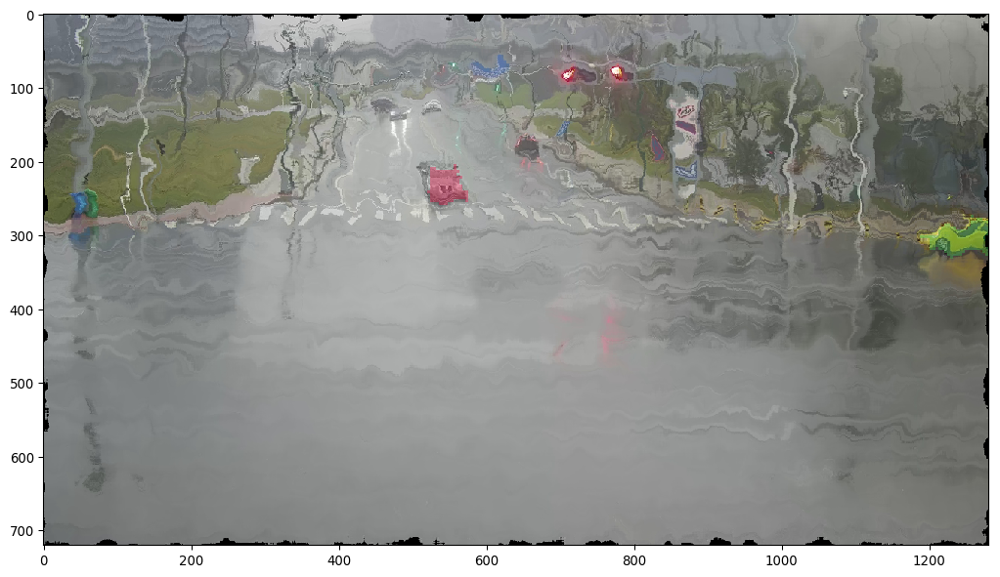

In [41]:
aug = iaa.ElasticTransformation(alpha=200, sigma=10)

image_aug, segmap_small_aug = aug(image=image, segmentation_maps=segmap_small)

ia.imshow(segmap_small_aug.draw_on_image(image_aug, alpha=0.4)[0])

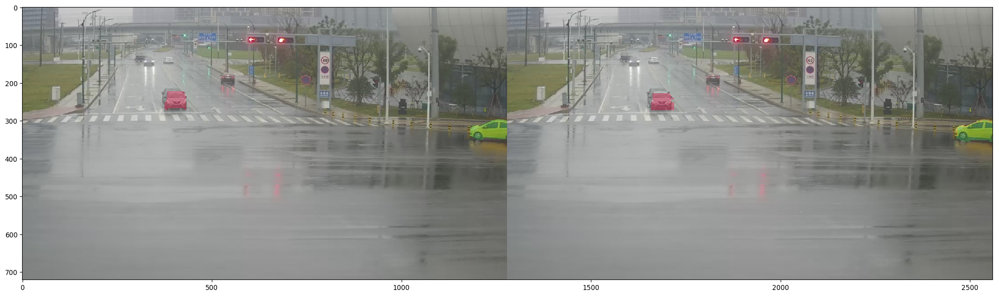

In [42]:
aug = iaa.Crop(px=(0, 0, 50, 200))  # (top, right, bottom, left)

# We have to augment two segmentation maps with the exactly same random values.
# This is why we switch to deterministic mode here, which resets the random state after
# each augmentation.
# (Due to using non-stochastic crop values, we could also skip this, but it seems cleaner
# to do it.)
aug_det = aug.to_deterministic()
image_aug = aug_det.augment_image(image)  # augment image
segmap_aug = aug_det.augment_segmentation_maps(segmap)  # augment normal-sized segmentation map
segmap_small_aug = aug_det.augment_segmentation_maps(segmap_small)  # augment smaller-sized segmentation map

ia.imshow(np.hstack([
    segmap_aug.draw_on_image(image_aug, alpha=0.4)[0],  # draw augmented normal-sized segmentation map
    segmap_small_aug.draw_on_image(image_aug, alpha=0.4)[0]  # draw augmented smaller-sized segmentation map
]))

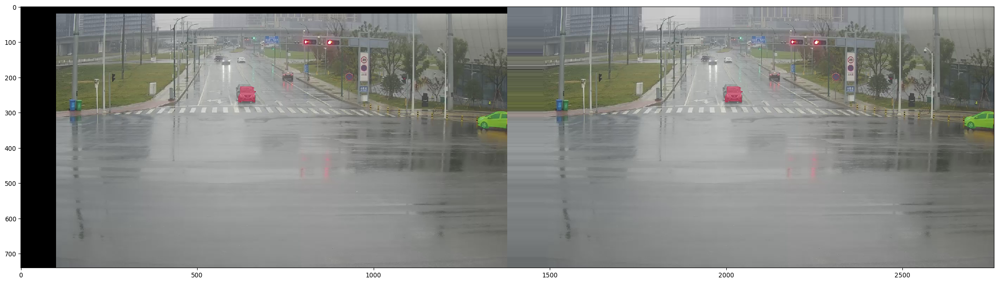

In [43]:
image_pad_constant = ia.pad(image, left=100, top=20)  # mode="constant" and cval=0 are the defaults of pad()
segmap_pad_constant = segmap.pad(left=100, top=20)    # mode="constant" and cval=0 are the defaults of pad()

image_pad_edge = ia.pad(image, left=100, top=20, mode="edge")
segmap_pad_edge = segmap.pad(left=100, top=20, mode="edge")

ia.imshow(np.hstack([
    segmap_pad_constant.draw_on_image(image_pad_constant, alpha=0.5)[0],
    segmap_pad_edge.draw_on_image(image_pad_edge, alpha=0.5)[0],
]))

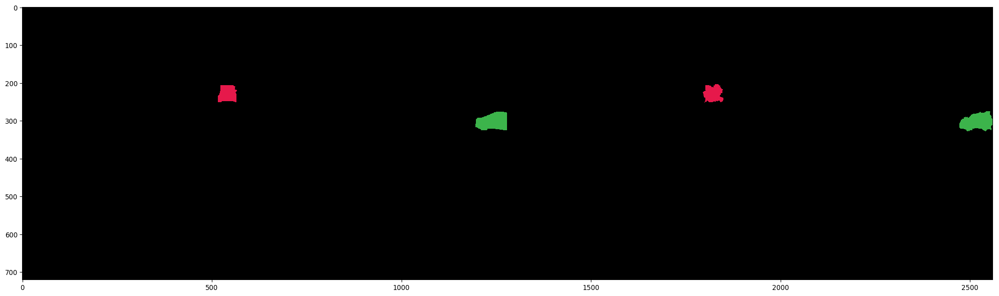

In [44]:
segmap_aug = iaa.ElasticTransformation(alpha=50, sigma=5).augment_segmentation_maps(segmap)
ia.imshow(np.hstack([
    segmap.draw()[0],
    segmap_aug.draw()[0],
]))

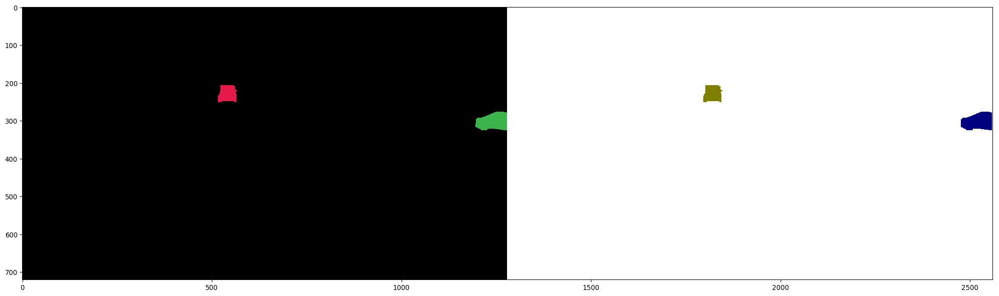

In [45]:
ia.imshow(np.hstack([
    segmap.draw()[0],
    segmap.draw(colors=[(255, 255, 255), (128, 128, 0), (0, 0, 128)])[0],
]))

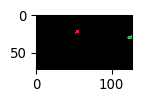

In [46]:
ia.imshow(segmap.draw(0.1)[0])

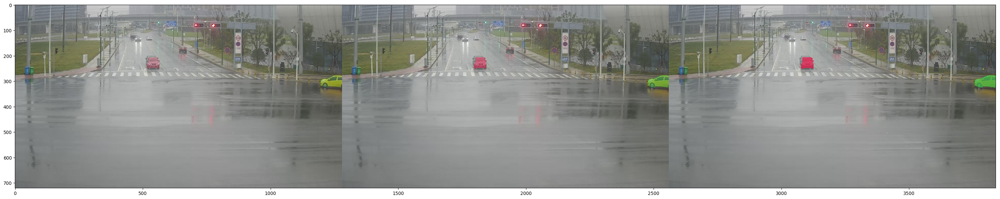

In [47]:
ia.imshow(np.hstack([
    segmap.draw_on_image(image, alpha=0.25)[0],
    segmap.draw_on_image(image, alpha=0.50)[0],
    segmap.draw_on_image(image, alpha=0.75)[0]
]))

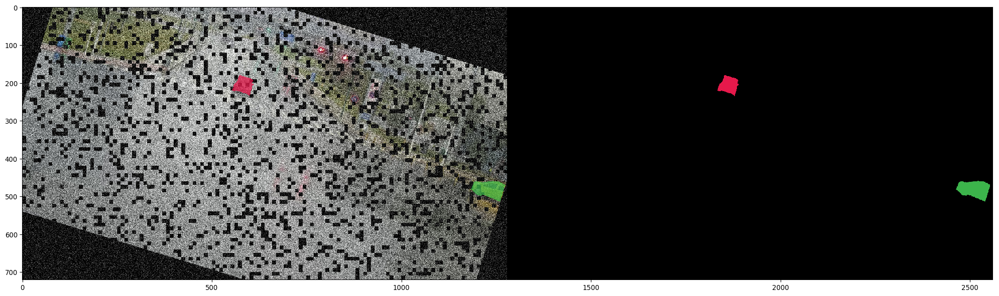

In [48]:
# example augmentation pipeline
aug = iaa.Sequential([
    iaa.Affine(rotate=(-20, 20)),  # only this affects segmentation maps via augment_segmentation_maps()
    iaa.CoarseDropout(0.2, size_percent=0.1),
    iaa.AdditiveGaussianNoise(scale=0.2*255)
])

# standard way of augmenting segmentation maps via augment_segmentation_maps()
image_aug, segmap_aug = aug(image=image, segmentation_maps=segmap)

# visualize before/after
ia.imshow(np.hstack([
    segmap_aug.draw_on_image(image_aug)[0],
    segmap_aug.draw()[0]
]))

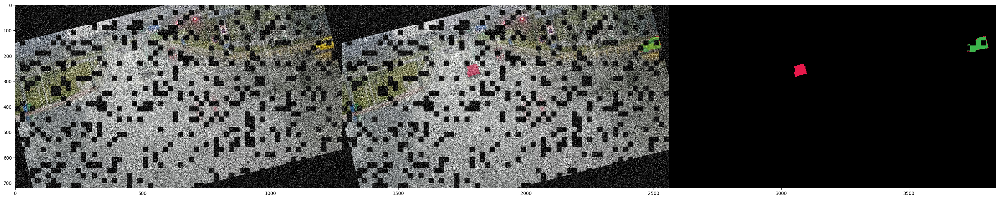

In [49]:
# augmentation pipeline for images
aug_images = iaa.Sequential([
    iaa.Affine(rotate=(-20, 20), random_state=1),
    iaa.CoarseDropout(0.2, size_percent=0.05, random_state=2),
    iaa.AdditiveGaussianNoise(scale=0.2*255, random_state=3)
], random_state=4)

# augmentation pipeline for segmentation maps - with coarse dropout, but without gaussian noise
aug_segmaps = iaa.Sequential([
    iaa.Affine(rotate=(-20, 20), random_state=1),
    iaa.CoarseDropout(0.2, size_percent=0.05, random_state=2)
], random_state=4)

# First, augment image.
image_aug = aug_images(image=image)

# Second, augment segmentation map.
# We convert to uint8 as that dtype has usually best support and hence is safest to use.
segmap_arr_aug = aug_segmaps(image=segmap.get_arr().astype(np.uint8))
segmap_aug = SegmentationMapsOnImage(segmap_arr_aug, shape=segmap.shape)

# visualize
ia.imshow(np.hstack([
    image_aug,
    segmap_aug.draw_on_image(image_aug, alpha=0.5)[0],
    segmap_aug.draw()[0]
]))

### albumentations

In [50]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
    
from  albumentations  import (
    HorizontalFlip, IAAPerspective, ShiftScaleRotate, CLAHE, RandomRotate90,
    Transpose, ShiftScaleRotate, Blur, OpticalDistortion, GridDistortion, HueSaturationValue,
    IAAAdditiveGaussianNoise, GaussNoise, MotionBlur, MedianBlur, IAAPiecewiseAffine,
    IAASharpen, IAAEmboss, RandomContrast, RandomBrightness, Flip, OneOf, Compose
) # 图像变换函数

In [51]:
image = cv2.imread('zq/1.jpg', 1) # BGR
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  #转为RGB
aug = HorizontalFlip(p=1)
img_HorizontalFlip = aug(image=image)['image']
    
aug = IAAPerspective(scale=0.2, p=1)
img_IAAPerspective = aug(image=image)['image']
    
aug = ShiftScaleRotate(p=1)
img_ShiftScaleRotate = aug(image=image)['image']

In [52]:
def  augment_flips_color(p=.5):
    return Compose([
        CLAHE(),
        RandomRotate90(),
        Transpose(),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.50, rotate_limit=45, p=.75),
        Blur(blur_limit=3),
        OpticalDistortion(),
        GridDistortion(),
        HueSaturationValue()
    ], p=p)

In [53]:
aug = augment_flips_color(p=1)
img_augment_flips_color = aug(image=image)['image']

In [54]:
def strong_aug(p=.5):
    return Compose([
        RandomRotate90(),
        Flip(),
        Transpose(),
        OneOf([
            IAAAdditiveGaussianNoise(),
            GaussNoise(),
        ], p=0.2),
        OneOf([
            MotionBlur(p=.2),
            MedianBlur(blur_limit=3, p=.1),
            Blur(blur_limit=3, p=.1),
        ], p=0.2),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=45, p=.2),
        OneOf([
            OpticalDistortion(p=0.3),
            GridDistortion(p=.1),
            IAAPiecewiseAffine(p=0.3),
        ], p=0.2),
        OneOf([
            CLAHE(clip_limit=2),
            IAASharpen(),
            IAAEmboss(),
            RandomContrast(),
            RandomBrightness(),
        ], p=0.3),
        HueSaturationValue(p=0.3),
    ], p=p)

In [55]:
aug  ==  strong_aug(p=1)
img_strong_aug = aug(image=image)['image']

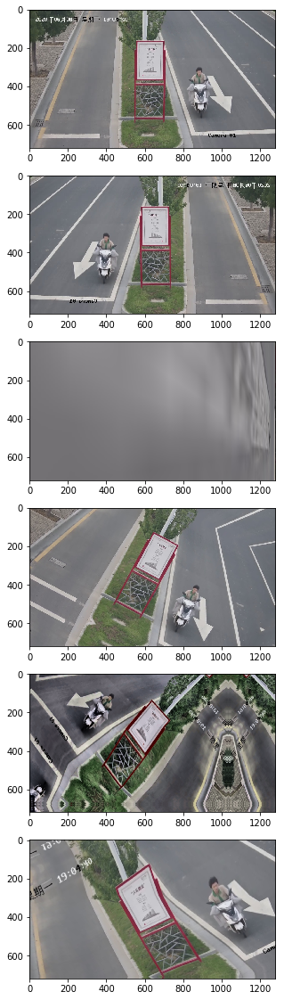

In [56]:
plt.figure(figsize=(10,20))
plt.subplot(6, 1, 1)
plt.imshow(image)
plt.subplot(6, 1, 2)
plt.imshow(img_HorizontalFlip)
plt.subplot(6, 1,3)
plt.imshow(img_IAAPerspective)
plt.subplot(6, 1, 4)
plt.imshow(img_ShiftScaleRotate)
plt.subplot(6, 1, 5)
plt.imshow(img_augment_flips_color)
plt.subplot(6, 1, 6)
plt.imshow(img_strong_aug)
plt.show()

### keras.proprecessing.image

In [57]:
from tensorflow import keras

In [58]:
image = keras.preprocessing.image.load_img('./zq/1.jpg')

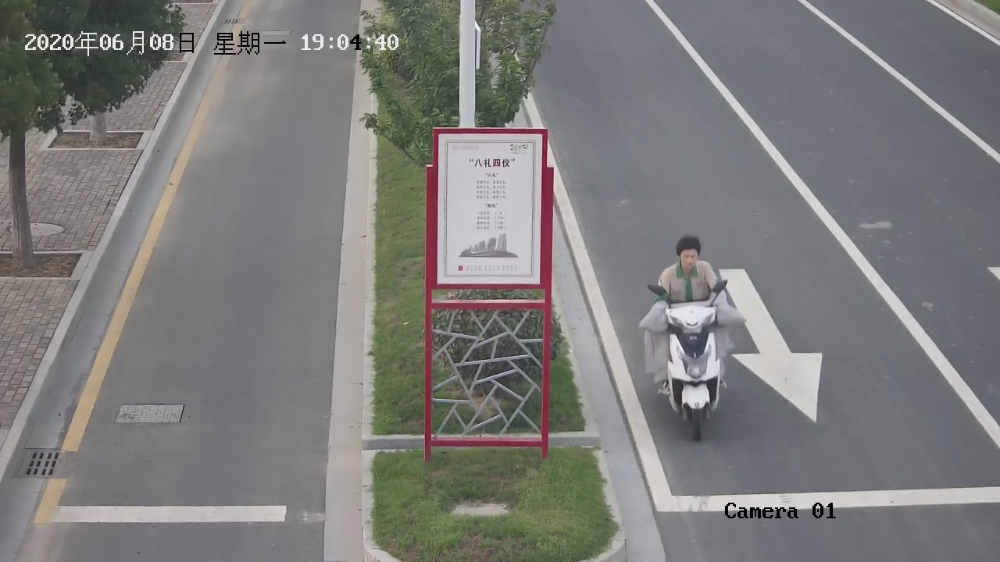

In [59]:
image

In [60]:
data = keras.preprocessing.image.ImageDataGenerator(
    featurewise_center=True,
    featurewise_std_normalization=True,  #按功能将输入除以数据集的std。
    rotation_range=20,                     #随机旋转的度数范围。
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True)